In [8]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA, TruncatedSVD
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, precision_score, recall_score, confusion_matrix
np.random.seed(42)
print("Libraries imported successfully.")

Libraries imported successfully.


In [9]:
# Dataset
file_path = ''
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        if '.csv' in filename:
            file_path = os.path.join(dirname, filename)
            print(f"Dataset found: {file_path}")
            break
    if file_path:
        break

# Load the dataset
df = pd.read_csv(file_path)

# --- Initial Analysis & Pre-Processing ---

# 1. Map categorical labels to numerical format
# We'll use 1 for 'FAKE' and 0 for 'REAL'
df['LABEL'] = df['LABEL'].map({'FAKE': 1, 'REAL': 0})

# 2. Check for missing values
print(f"\nContains NaN values: {df.isna().any().any()}")
print(f"Contains null values: {df.isnull().any().any()}")

# 3. Shuffle the dataset to ensure randomness
df = df.sample(frac=1, random_state=42).reset_index(drop=True)

# 4. Separate features (X) and target (y)
X = df.drop(columns=['LABEL']).values
y = df['LABEL'].values

# 5. Display dataset info
print("\nDataset shape:", df.shape)
print("Features shape:", X.shape)
print("Target shape:", y.shape)
print("\nFirst 5 rows of the processed DataFrame:")
df.head()

Dataset found: /kaggle/input/deep-voice-deepfake-voice-recognition/KAGGLE/DATASET-balanced.csv

Contains NaN values: False
Contains null values: False

Dataset shape: (11778, 27)
Features shape: (11778, 26)
Target shape: (11778,)

First 5 rows of the processed DataFrame:


,chroma_stft,rms,spectral_centroid,spectral_bandwidth,rolloff,zero_crossing_rate,mfcc1,mfcc2,mfcc3,mfcc4,...,mfcc12,mfcc13,mfcc14,mfcc15,mfcc16,mfcc17,mfcc18,mfcc19,mfcc20,LABEL
0,0.441114,0.079663,922.780253,1385.841230,1606.028439,0.023917,-320.896545,211.678055,10.367925,-17.441900,...,-2.236197,1.552115,2.843510,4.692409,3.106334,-4.299569,-5.380206,4.532225,5.579152,0
1,0.432119,0.039595,2413.310510,2980.346767,4658.142160,0.048391,-357.386597,141.067474,-8.478411,50.100609,...,-5.744374,3.693567,4.884624,-0.293556,9.605581,-0.679518,6.833396,0.411718,-0.786885,1
2,0.370716,0.013605,3116.226937,3141.811112,5179.419933,0.090177,-445.311676,135.565094,-18.134920,19.937037,...,-9.979925,-8.667892,-5.452301,-3.327649,-8.551641,-9.594158,-5.171256,-11.394002,-16.235928,1
3,0.354024,0.029757,2119.633001,2534.221251,3645.279255,0.049672,-358.246521,182.810425,-51.112995,22.122393,...,-20.808508,-1.759383,1.881368,-7.776491,-7.425082,-11.308017,0.909932,-7.334956,-3.903934,0
4,0.441625,0.057751,2862.566856,3206.461251,4667.844347,0.081123,-328.314270,110.892700,-23.511282,21.168459,...,-5.999317,-4.273880,-7.507450,-3.208905,-4.326396,-1.923048,-3.697001,-1.108554,-5.886751,1


In [10]:
print("\n[1] DATASET OVERVIEW & DATA TYPES")
print("-------------------------------------")
features = df.drop('LABEL', axis=1)
features.info()



[1] DATASET OVERVIEW & DATA TYPES
-------------------------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11778 entries, 0 to 11777
Data columns (total 26 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   chroma_stft         11778 non-null  float64
 1   rms                 11778 non-null  float64
 2   spectral_centroid   11778 non-null  float64
 3   spectral_bandwidth  11778 non-null  float64
 4   rolloff             11778 non-null  float64
 5   zero_crossing_rate  11778 non-null  float64
 6   mfcc1               11778 non-null  float64
 7   mfcc2               11778 non-null  float64
 8   mfcc3               11778 non-null  float64
 9   mfcc4               11778 non-null  float64
 10  mfcc5               11778 non-null  float64
 11  mfcc6               11778 non-null  float64
 12  mfcc7               11778 non-null  float64
 13  mfcc8               11778 non-null  float64
 14  mfcc9               11778 non

In [11]:
print("\n[2] STATISTICAL SUMMARY OF FEATURES")
print("-------------------------------------")
display(features.describe().T)
print("Observation: Features have vastly different scales. Feature scaling (like StandardScaler) is essential.")


[2] STATISTICAL SUMMARY OF FEATURES
-------------------------------------


,count,mean,std,min,25%,50%,75%,max
chroma_stft,11778.0,0.421925,0.069392,0.200353,0.372330,0.417708,0.467741,0.707202
rms,11778.0,0.037894,0.028071,0.000043,0.015098,0.031870,0.054046,0.168958
spectral_centroid,11778.0,2719.201373,1066.754739,756.163229,2062.875836,2579.963841,3283.857559,17685.006690
spectral_bandwidth,11778.0,3050.299988,872.258653,1096.903152,2569.289971,3055.863462,3581.271953,7836.844404
rolloff,11778.0,4977.617722,2170.158448,1063.964279,3448.144178,4683.958018,6211.301553,21130.544670
zero_crossing_rate,11778.0,0.070821,0.039292,0.015504,0.045749,0.060237,0.085149,0.812480
mfcc1,11778.0,-382.562312,79.593413,-1055.002197,-432.928848,-365.756241,-321.772781,-193.430145
mfcc2,11778.0,145.056311,36.188506,-83.816765,120.522711,145.970162,168.321331,284.727997
mfcc3,11778.0,-24.699932,27.728976,-132.491104,-35.550402,-19.164229,-6.235028,67.475792
mfcc4,11778.0,21.311292,22.480432,-47.770000,3.635681,22.218458,37.017731,86.585747


Observation: Features have vastly different scales. Feature scaling (like StandardScaler) is essential.


use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN be

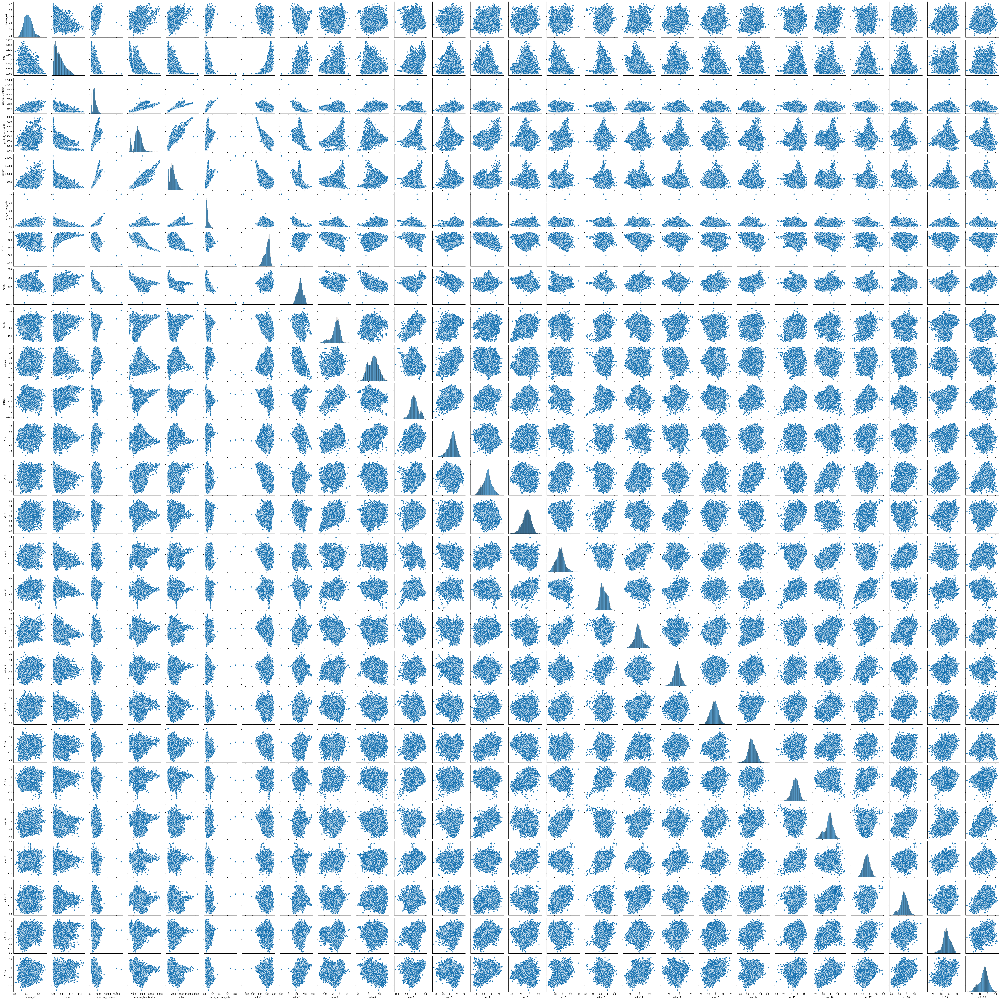

In [31]:
# Replace inf/-inf with NaN
features = features.replace([np.inf, -np.inf], np.nan)

# pairplot
sns.pairplot(features)


[3] TARGET VARIABLE (LABEL) DISTRIBUTION
------------------------------------------


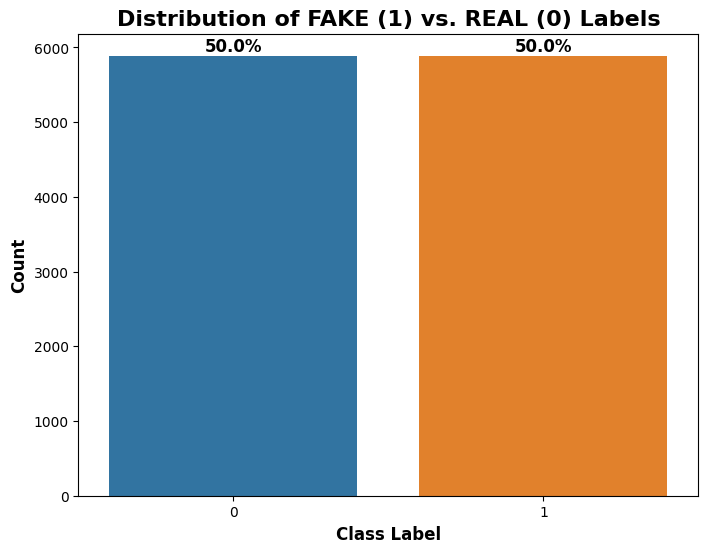

Value Counts:
LABEL
0    5889
1    5889
Name: count, dtype: int64
Observation: The dataset is perfectly balanced. No class-weight adjustments needed.


In [12]:
print("\n[3] TARGET VARIABLE (LABEL) DISTRIBUTION")
print("------------------------------------------")
plt.figure(figsize=(8, 6))
ax = sns.countplot(x='LABEL', data=df)
plt.title('Distribution of FAKE (1) vs. REAL (0) Labels', fontsize=16, weight='bold')
plt.xlabel('Class Label', fontsize=12, weight='bold')
plt.ylabel('Count', fontsize=12, weight='bold')

total = len(df['LABEL'])
for p in ax.patches:
    percentage = f'{100 * p.get_height() / total:.1f}%'
    x = p.get_x() + p.get_width() / 2
    y = p.get_height()
    ax.annotate(percentage, (x, y), ha='center', va='bottom', fontsize=12, weight='bold')
plt.savefig('LABEL.png') 
plt.show()
print(f"Value Counts:\n{df['LABEL'].value_counts()}")
print("Observation: The dataset is perfectly balanced. No class-weight adjustments needed.")


[4] DISTRIBUTION OF INDIVIDUAL FEATURES
---------------------------------------


use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN be

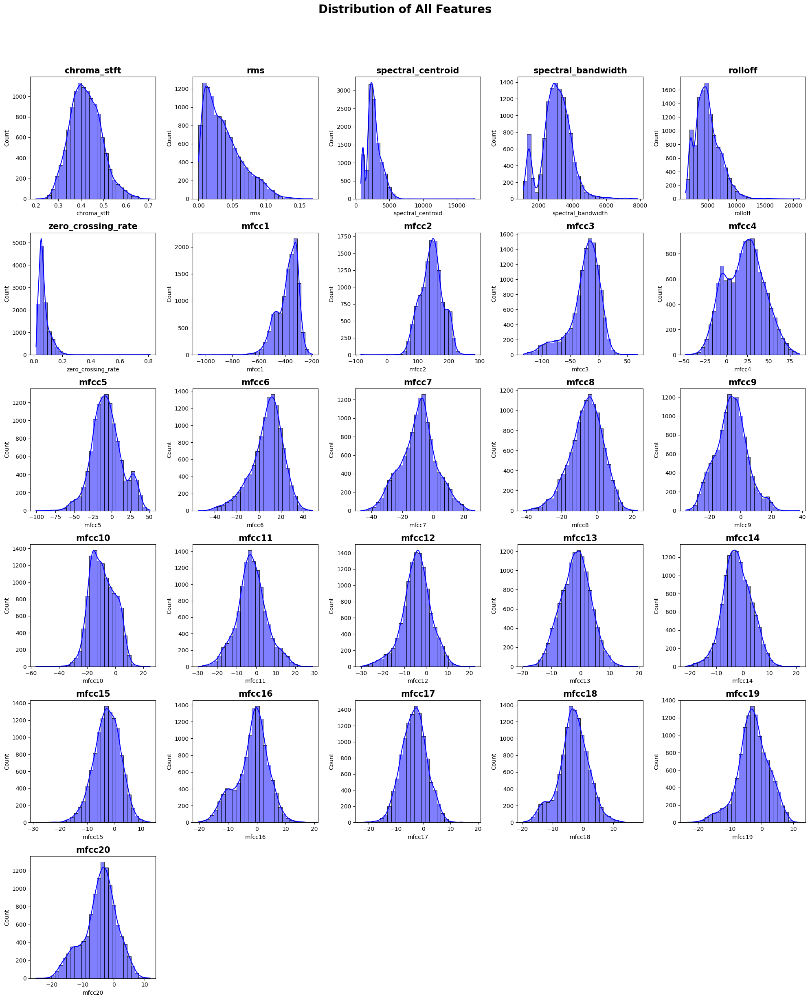

In [26]:
import matplotlib.pyplot as plt
import seaborn as sns

print("\n[4] DISTRIBUTION OF INDIVIDUAL FEATURES")
print("---------------------------------------")

# Set up the figure size for multiple subplots
num_features = len(features.columns)
cols = 5
rows = (num_features // cols) + (num_features % cols > 0)

plt.figure(figsize=(20, rows * 4))

for i, col in enumerate(features.columns, 1):
    plt.subplot(rows, cols, i)
    sns.histplot(features[col], bins=30, kde=True, edgecolor='black', color='blue')
    plt.title(f'{col}', fontsize=15, weight='bold')

plt.suptitle('Distribution of All Features', fontsize=20, y=1.02, weight='bold')
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.savefig('feature_distribution.png')  # Save the plot as a PNG file
plt.show()
plt.close()  # Close the plot to free memory

In [14]:
print("\n[5] NORMALITY CHECKS (SKEWNESS & KURTOSIS)")
print("------------------------------------------")
skew_kurt = pd.DataFrame({'Skewness': features.skew(), 'Kurtosis': features.kurt()})
display(skew_kurt)
print("Observation: Features with high skewness (>1 or <-1) are far from normal. Consider log or Box-Cox transformations if needed.")


[5] NORMALITY CHECKS (SKEWNESS & KURTOSIS)
------------------------------------------


,Skewness,Kurtosis
chroma_stft,0.350193,0.074744
rms,0.949575,0.424450
spectral_centroid,1.347987,11.319191
spectral_bandwidth,0.318902,1.661155
rolloff,0.980930,2.202774
zero_crossing_rate,3.209805,38.196828
mfcc1,-0.894908,1.418885
mfcc2,-0.045518,0.047836
mfcc3,-1.136568,1.343475
mfcc4,0.034706,-0.570632


Observation: Features with high skewness (>1 or <-1) are far from normal. Consider log or Box-Cox transformations if needed.


In [15]:
# Covariance of Features
features.cov()

,chroma_stft,rms,spectral_centroid,spectral_bandwidth,rolloff,zero_crossing_rate,mfcc1,mfcc2,mfcc3,mfcc4,...,mfcc11,mfcc12,mfcc13,mfcc14,mfcc15,mfcc16,mfcc17,mfcc18,mfcc19,mfcc20
chroma_stft,0.004815,-0.000580,2.656128e+01,2.084755e+01,5.927967e+01,0.000938,-1.267222,-0.594189,0.122297,0.336036,...,0.149866,0.148513,0.046034,0.060352,0.042562,0.059740,0.067599,0.067338,0.062032,0.044523
rms,-0.000580,0.000788,-1.712825e+01,-1.699041e+01,-3.313914e+01,-0.000467,1.689074,0.424634,0.222550,-0.176306,...,-0.057835,-0.000999,-0.029180,-0.003838,0.023436,-0.008690,0.005159,0.010915,0.029230,0.046316
spectral_centroid,26.561281,-17.128245,1.137966e+06,7.483574e+05,2.203659e+06,38.691088,-36161.396967,-33891.831526,-3053.315819,13936.205865,...,-1019.442642,58.490169,-866.634029,-1622.015484,-1137.748644,-1798.435238,-612.821167,-1544.176318,-1376.603841,-3068.977904
spectral_bandwidth,20.847549,-16.990410,7.483574e+05,7.608352e+05,1.639035e+06,19.055505,-47555.243452,-23318.122607,1942.188578,9218.033303,...,-119.175143,576.280510,81.978488,-665.716056,-492.849882,-571.216786,20.043898,-669.347510,-906.763192,-1808.275175
rolloff,59.279671,-33.139136,2.203659e+06,1.639035e+06,4.709588e+06,68.673489,-75686.683675,-65662.557409,-1498.094050,28582.178010,...,-2086.474643,249.716148,-1299.324312,-2735.708156,-1819.857580,-3164.469854,-637.150839,-2784.063388,-2158.156841,-5477.750329
zero_crossing_rate,0.000938,-0.000467,3.869109e+01,1.905551e+01,6.867349e+01,0.001544,-0.885840,-1.100901,-0.156466,0.403521,...,-0.041814,-0.010231,-0.045496,-0.065143,-0.046907,-0.068480,-0.036321,-0.060769,-0.045510,-0.102566
mfcc1,-1.267222,1.689074,-3.616140e+04,-4.755524e+04,-7.568668e+04,-0.885840,6335.111439,768.858674,-359.464808,-126.754009,...,-135.374395,-11.291118,-82.454795,-84.329859,14.313913,-85.176407,-26.757597,4.620877,12.494031,23.849324
mfcc2,-0.594189,0.424634,-3.389183e+04,-2.331812e+04,-6.566256e+04,-1.100901,768.858674,1309.607997,-61.028023,-532.073350,...,74.475497,-11.417981,35.362910,76.333719,22.181212,76.843902,15.636367,37.840048,53.492831,112.026776
mfcc3,0.122297,0.222550,-3.053316e+03,1.942189e+03,-1.498094e+03,-0.156466,-359.464808,-61.028023,768.896101,72.175614,...,-62.121394,39.267808,-8.500557,23.077595,44.408032,2.720460,35.138505,15.910087,40.011257,31.001093
mfcc4,0.336036,-0.176306,1.393621e+04,9.218033e+03,2.858218e+04,0.403521,-126.754009,-532.073350,72.175614,505.369817,...,-17.570056,-6.970202,-8.209125,-12.208240,-1.759332,-28.587518,7.741926,-2.912282,-13.136680,-43.294128



[6] COVARIANCE & CORRELATION
-----------------------------


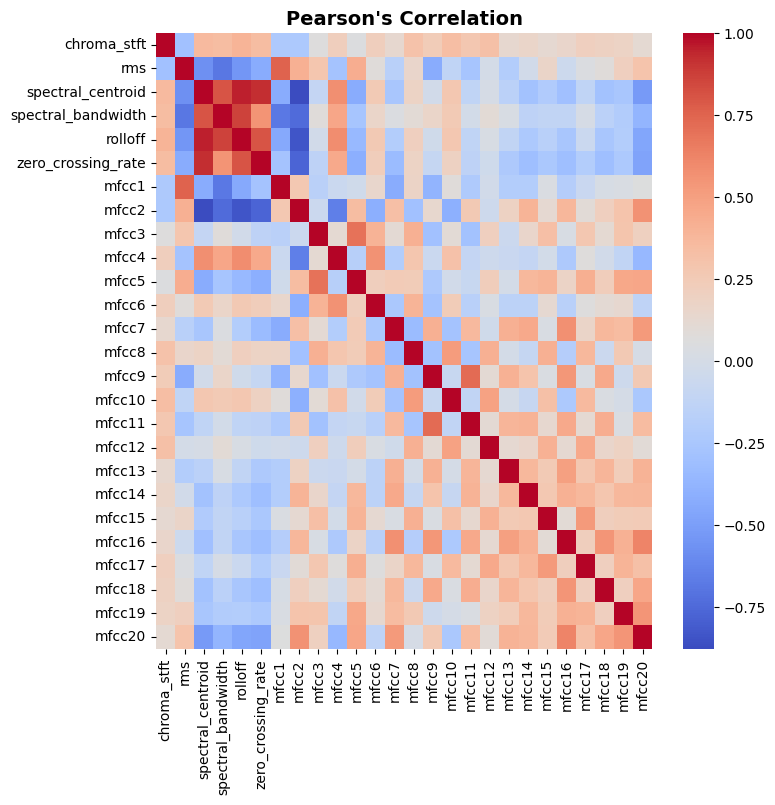

Observation: Highly correlated features exist (multicollinearity). PCA or regularization can help for linear models.


In [27]:
print("\n[6] COVARIANCE & CORRELATION")
print("-----------------------------")
cov_matrix = features.cov()
corr_matrix = features.corr()
pearson_corr_matrix = features.corr(method='pearson')

plt.figure(figsize=(8,8))
sns.heatmap(corr_matrix, cmap='coolwarm', annot=False)
plt.title(r"Pearson's Correlation", fontsize=14, weight='bold')
plt.savefig('CORRELATION.png') 
plt.show()

print("Observation: Highly correlated features exist (multicollinearity). PCA or regularization can help for linear models.")


[8] FEATURE DISTRIBUTIONS PER CLASS (REAL vs. FAKE)
--------------------------------------------------


/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  

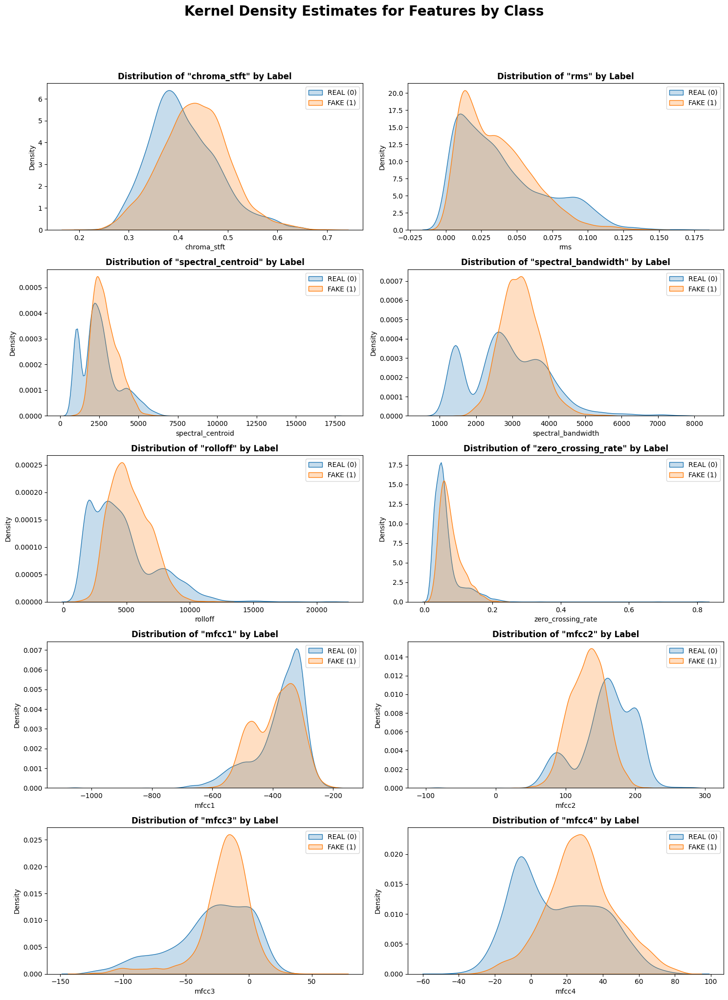

In [16]:
print("\n[8] FEATURE DISTRIBUTIONS PER CLASS (REAL vs. FAKE)")
print("--------------------------------------------------")
feature_names = features.columns
features_to_plot = feature_names[:10]
n_cols = 2
n_rows = (len(features_to_plot) + n_cols - 1) // n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 4))
axes = axes.flatten()

for i, feature in enumerate(features_to_plot):
    sns.kdeplot(df[df['LABEL'] == 0][feature], ax=axes[i], label='REAL (0)', fill=True)
    sns.kdeplot(df[df['LABEL'] == 1][feature], ax=axes[i], label='FAKE (1)', fill=True)
    axes[i].set_title(f'Distribution of "{feature}" by Label', fontsize=12, weight='bold')
    axes[i].legend()

for j in range(i + 1, len(axes)):
    axes[j].set_visible(False)

plt.suptitle('Kernel Density Estimates for Features by Class', fontsize=20, y=1.02, weight='bold')
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.savefig('DISTRIBUTIONS.png')
plt.show()

--- Generating Static Spectral Profile Plots ---


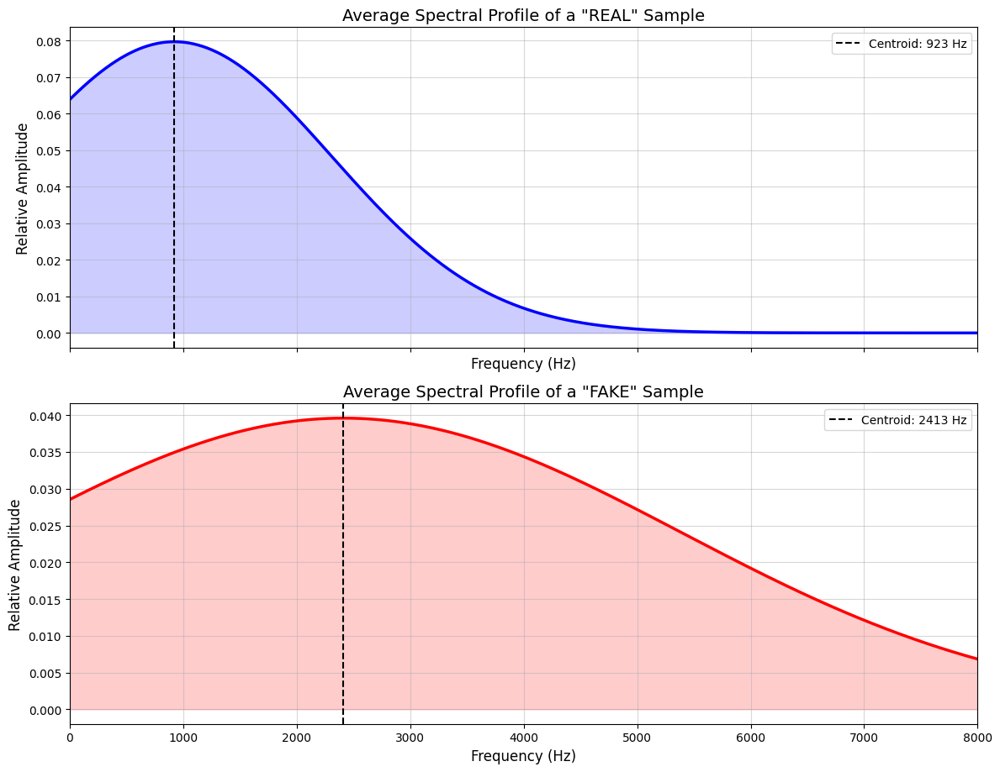

In [28]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm

print("--- Generating Static Spectral Profile Plots ---")

# --- 1. Function to Plot the Spectral Profile ---
def plot_spectral_profile(sample, sample_type, ax):

    # --- Find the correct feature names robustly ---
    try:
        centroid_col = [col for col in sample.index if 'centroid' in col][0]
        bandwidth_col = [col for col in sample.index if 'bandwidth' in col][0]
        rms_col = [col for col in sample.index if 'rms' in col][0]
    except IndexError:
        print("Error: Could not find required spectral feature columns (centroid, bandwidth, rms).")
        return

    # --- Extract key features ---
    # The center of our spectral energy
    center_frequency = sample[centroid_col]
    # The spread of our spectral energy (standard deviation)
    spread = sample[bandwidth_col]
    # The overall amplitude/power of the signal
    amplitude = sample[rms_col]
    
    # We need a plausible standard deviation for the plot
    if spread <= 0: spread = 1e-3 # Avoid division by zero

    # --- Create the frequency axis ---
    freq_range = np.linspace(0, 8000, 1000) # Plot up to 8kHz

    # --- Generate the spectral shape using a Normal (Gaussian) distribution ---
    # The PDF of the normal distribution is a perfect model for this
    spectral_shape = norm.pdf(freq_range, loc=center_frequency, scale=spread)
    
    # Scale the shape by the amplitude (RMS)
    scaled_spectral_shape = spectral_shape * amplitude / np.max(spectral_shape)

    # --- Plotting ---
    color = 'blue' if sample_type == 'REAL' else 'red'
    ax.plot(freq_range, scaled_spectral_shape, color=color, linewidth=2.5)
    ax.fill_between(freq_range, scaled_spectral_shape, color=color, alpha=0.2)
    
    # Add a vertical line for the centroid
    ax.axvline(x=center_frequency, color='k', linestyle='--', label=f'Centroid: {center_frequency:.0f} Hz')
    
    ax.set_title(f'Average Spectral Profile of a "{sample_type}" Sample', fontsize=14)
    ax.set_xlabel('Frequency (Hz)', fontsize=12)
    ax.set_ylabel('Relative Amplitude', fontsize=12)
    ax.grid(True, alpha=0.5)
    ax.set_xlim(0, 8000)
    ax.legend()


# --- 2. Select One REAL and One FAKE Sample ---
real_audio_sample = df[df['LABEL'] == 0].iloc[0]
fake_audio_sample = df[df['LABEL'] == 1].iloc[0]

# --- 3. Create the plots ---
fig, axes = plt.subplots(2, 1, figsize=(12, 10), sharex=True)
plot_spectral_profile(real_audio_sample, 'REAL', axes[0])
plot_spectral_profile(fake_audio_sample, 'FAKE', axes[1])

# fig.suptitle('Visualizing the Average Frequency Content', fontsize=20, y=0.96)
plt.tight_layout(rect=[0, 0, 1, 0.93])
plt.savefig('Frequency.png')
plt.show()

In [19]:
# --- Data Preparation ---
# Define features (X) and target (y) from the main DataFrame
print("Defining features (X) and target (y)...")
X = df.drop('LABEL', axis=1)  # X is all columns EXCEPT 'LABEL'
y = df['LABEL']              
# y is ONLY the 'LABEL' column

# Verify the shapes to ensure they are correct
# X should be 2D (samples, features) and y should be 1D (samples,)
print(f"Shape of X: {X.shape}")
print(f"Shape of y: {y.shape}\n")

# --- Data Splitting and Scaling ---
print("Splitting and scaling data...")
# Split data into training (80%) and testing (20%) sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Initialize a scaler
scaler = StandardScaler()

# Fit the scaler ONLY on the training data
scaler.fit(X_train)

# Apply the scaler to both training and test data
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

print(f"Training data shape: {X_train_scaled.shape}")
print(f"Testing data shape: {X_test_scaled.shape}")

Defining features (X) and target (y)...
Shape of X: (11778, 26)
Shape of y: (11778,)

Splitting and scaling data...
Training data shape: (9422, 26)
Testing data shape: (2356, 26)


In [20]:
# Analysis: Dimensionality Reduction
"""
PCA (Principal Component Analysis):
    - Unsupervised method.
    - Identifies directions (principal components) that capture the maximum variance in the data.

SVD (Singular Value Decomposition):
    - Unsupervised method, often applied using TruncatedSVD.
    - Works well for sparse data and produces results similar to PCA.

LDA (Linear Discriminant Analysis):
    - Supervised method.
    - Finds a feature subspace that maximizes class separability.
"""

N_COMPONENTS = 10  # Number of dimensions to reduce to

# --- 1. Principal Component Analysis (PCA) ---
pca = PCA(n_components=N_COMPONENTS)
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)
print(f"Data shape after PCA: {X_train_pca.shape}")

# --- 2. Singular Value Decomposition (SVD) ---
svd = TruncatedSVD(n_components=N_COMPONENTS, random_state=42)
X_train_svd = svd.fit_transform(X_train_scaled)
X_test_svd = svd.transform(X_test_scaled)
print(f"Data shape after SVD: {X_train_svd.shape}")

# --- 3. Linear Discriminant Analysis (LDA) ---
# LDA is supervised, so it uses y_train for fitting.
# The number of components in LDA is at most min(n_classes - 1, n_features).
# Here, n_classes is 2, so we can only reduce to 1 component.
lda = LDA(n_components=1)
X_train_lda = lda.fit_transform(X_train_scaled, y_train)
X_test_lda = lda.transform(X_test_scaled)
print(f"Data shape after LDA: {X_train_lda.shape}")

# Store all datasets in a dictionary for easy access
datasets = {
    "Original Scaled": (X_train_scaled, X_test_scaled),
    "PCA": (X_train_pca, X_test_pca),
    "SVD": (X_train_svd, X_test_svd),
    "LDA": (X_train_lda, X_test_lda)
}




Data shape after PCA: (9422, 10)
Data shape after SVD: (9422, 10)
Data shape after LDA: (9422, 1)


/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)


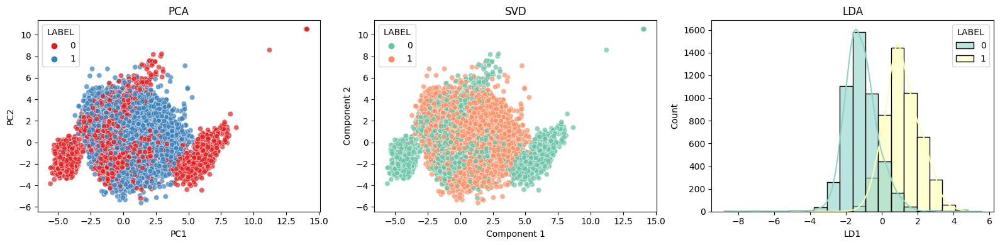

In [21]:
import matplotlib.pyplot as plt
import seaborn as sns

# --- 1. PCA plot (first 2 components) ---
plt.figure(figsize=(16, 4))
plt.subplot(1, 3, 1)
sns.scatterplot(x=X_train_pca[:, 0], y=X_train_pca[:, 1], hue=y_train, palette='Set1', alpha=0.7)
plt.title('PCA')
plt.xlabel('PC1')
plt.ylabel('PC2')

# --- 2. SVD plot (first 2 components) ---
plt.subplot(1, 3, 2)
sns.scatterplot(x=X_train_svd[:, 0], y=X_train_svd[:, 1], hue=y_train, palette='Set2', alpha=0.7)
plt.title('SVD')
plt.xlabel('Component 1')
plt.ylabel('Component 2')

# --- 3. LDA plot (1 component) ---
plt.subplot(1, 3, 3)
sns.histplot(x=X_train_lda[:, 0], hue=y_train, palette='Set3', bins=20, kde=True, alpha=0.6)
plt.title('LDA')
plt.xlabel('LD1')
plt.ylabel('Count')

plt.tight_layout()
plt.savefig('PCA.png')
plt.show()


In [22]:
# Analysis: Classical Machine Learning Models

"""
We will train and evaluate two classical models:
    1. Logistic Regression
    2. K-Nearest Neighbors (KNN)

These models will be tested on each of our preprocessed datasets:
    - Original
    - PCA
    - SVD
    - LDA
"""

# --- Model Training and Evaluation ---

# Helper function to evaluate models and return metrics
def evaluate_model(model, X_test, y_test):
    y_pred = model.predict(X_test)
    y_proba = model.predict_proba(X_test)[:, 1] # For AUC
    
    metrics = {
        'Accuracy': accuracy_score(y_test, y_pred),
        'Precision': precision_score(y_test, y_pred),
        'Recall': recall_score(y_test, y_pred),
        'F1-Score': f1_score(y_test, y_pred),
        'AUC': roc_auc_score(y_test, y_proba)
    }
    return metrics

# Define the models to be tested
models = {
    "Logistic Regression": LogisticRegression(random_state=42, max_iter=1000),
    "K-Nearest Neighbors": KNeighborsClassifier(n_neighbors=10)
}

results = []

# Loop through each dimensionality reduction technique
for dr_name, (X_train_dr, X_test_dr) in datasets.items():
    # Loop through each model
    for model_name, model in models.items():
        print(f"Training {model_name} on {dr_name} data...")
        
        # Train the model
        model.fit(X_train_dr, y_train)
        
        # Evaluate the model
        metrics = evaluate_model(model, X_test_dr, y_test)
        
        # Store results
        result_entry = {'Model': model_name, 'Dimensionality Reduction': dr_name, **metrics}
        results.append(result_entry)

# Create a DataFrame to display results
results_df = pd.DataFrame(results)
print("\n--- Classical Model Performance ---")
results_df



Training Logistic Regression on Original Scaled data...
Training K-Nearest Neighbors on Original Scaled data...
Training Logistic Regression on PCA data...
Training K-Nearest Neighbors on PCA data...
Training Logistic Regression on SVD data...
Training K-Nearest Neighbors on SVD data...
Training Logistic Regression on LDA data...
Training K-Nearest Neighbors on LDA data...

--- Classical Model Performance ---


,Model,Dimensionality Reduction,Accuracy,Precision,Recall,F1-Score,AUC
0,Logistic Regression,Original Scaled,0.908319,0.915371,0.899830,0.907534,0.967831
1,K-Nearest Neighbors,Original Scaled,0.993209,0.996581,0.989813,0.993186,0.999443
2,Logistic Regression,PCA,0.817912,0.812865,0.825976,0.819368,0.891470
3,K-Nearest Neighbors,PCA,0.984295,0.991387,0.977080,0.984181,0.999108
4,Logistic Regression,SVD,0.817912,0.812865,0.825976,0.819368,0.891480
5,K-Nearest Neighbors,SVD,0.984720,0.991394,0.977929,0.984615,0.999115
6,Logistic Regression,LDA,0.893888,0.898625,0.887946,0.893254,0.960909
7,K-Nearest Neighbors,LDA,0.890917,0.898701,0.881154,0.889841,0.950841



--- Setting up model for SHAP explanation ---
SHAP values calculated successfully.

Generating Global Feature Importance Plot...


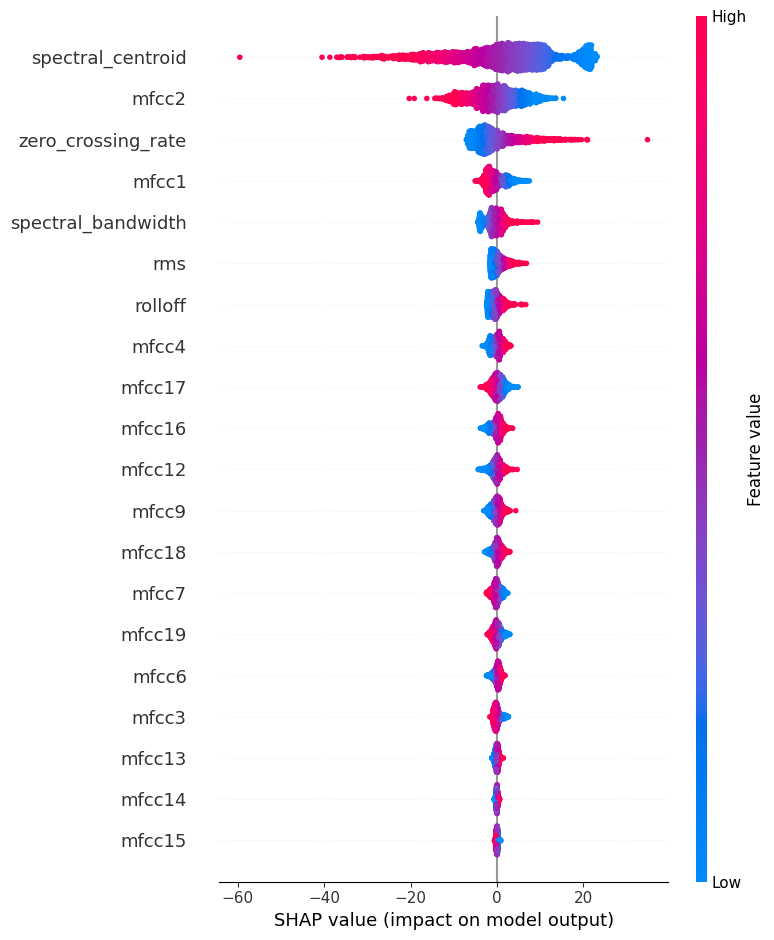


Generating Individual Prediction Explanation Plot (Waterfall)...


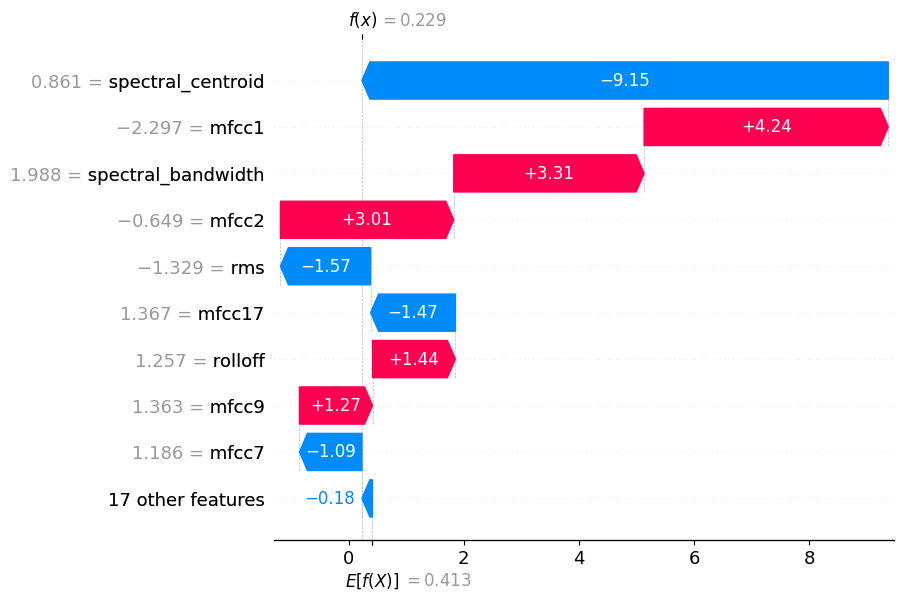

In [23]:
# First, ensure shap is installed
!pip install shap

import shap

# --- Step 1: Train a model on the most interpretable data ---
# For XAI, we want to explain predictions based on original features, not abstract components.
# So, we'll use the Logistic Regression model trained on the "Original Scaled" data.
print("\n--- Setting up model for SHAP explanation ---")
model_for_explanation = LogisticRegression(random_state=42, max_iter=1000)
model_for_explanation.fit(X_train_scaled, y_train)

# --- Step 2: Create a SHAP Explainer ---
# We use a LinearExplainer, which is optimized for linear models like Logistic Regression.
explainer = shap.LinearExplainer(model_for_explanation, X_train_scaled)

# --- Step 3: Calculate SHAP values for the test set ---
# This computes the contribution of each feature to each prediction in the test set.
shap_values = explainer.shap_values(X_test_scaled)
print("SHAP values calculated successfully.")


# --- Step 4: Generate SHAP Plots ---
print("\nGenerating Global Feature Importance Plot...")
shap.summary_plot(shap_values, X_test_scaled, feature_names=feature_names)

# Plot 2: Individual Prediction Explanation (Waterfall Plot)
# This plot breaks down a single prediction, showing how each feature contributed to the final score.
# We'll explain the first prediction in the test set.
print("\nGenerating Individual Prediction Explanation Plot (Waterfall)...")
shap.waterfall_plot(shap.Explanation(values=shap_values[0], 
                                     base_values=explainer.expected_value, 
                                     data=X_test_scaled[0], 
                                     feature_names=feature_names))


--- Analysis of SHAP Plots ---

--- Confusion Matrix Visualization ---


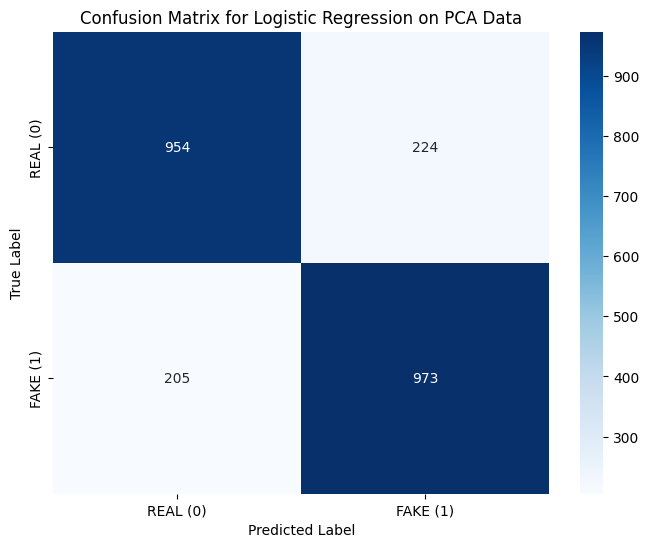

In [24]:
# --- XAI Plot Interpretation ---
print("\n--- Analysis of SHAP Plots ---")

# --- Confusion Matrix for the Best Performing Model ---
print("\n--- Confusion Matrix Visualization ---")
# From our results, Logistic Regression on PCA data was a top performer.
best_model = LogisticRegression(random_state=42, max_iter=1000)
best_model.fit(X_train_pca, y_train)
y_pred_best = best_model.predict(X_test_pca)

cm = confusion_matrix(y_test, y_pred_best)

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['REAL (0)', 'FAKE (1)'], 
            yticklabels=['REAL (0)', 'FAKE (1)'])
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix for Logistic Regression on PCA Data')
plt.savefig('Confusion.png')
plt.show()